# Colorful Dimension on a Binary Classifier

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
%config InlineBackend.figure_format = 'retina' #for HiDpi display

In [2]:
from colorfuldim import ActivationsHistogram

In [3]:
from fastai.vision import *

# Print current version
from fastai.version import __version__
print('fastai version: ', __version__)

fastai version:  1.0.53.dev0


Try to look at all the activations.

epoch,train_loss,valid_loss,accuracy,time
0,0.118314,0.055851,0.980373,00:11
1,0.050487,0.018362,0.995093,00:14
2,0.018959,0.019316,0.994112,00:16
3,0.009965,0.018109,0.995093,00:19


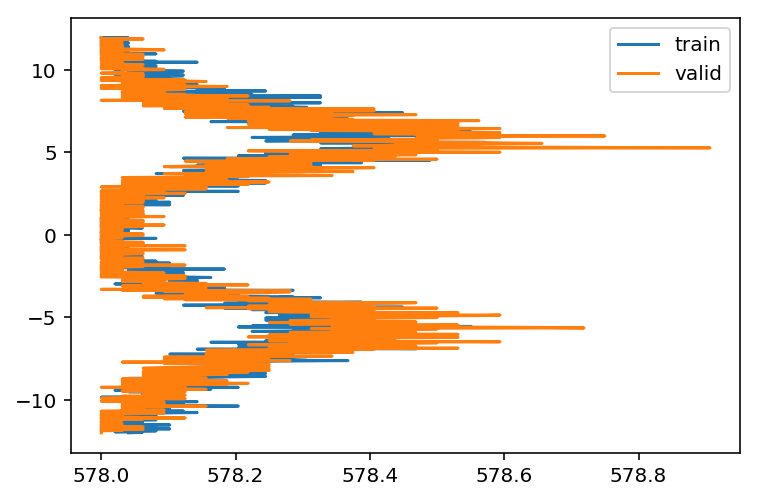

In [4]:
bs = 128
path = untar_data(URLs.MNIST_SAMPLE)
data = ImageDataBunch.from_folder(path)
actsh = partial(ActivationsHistogram, hMin=-12, hMax=12, nBins=800, modulesId=None)
learn = cnn_learner(data, models.resnet18, callback_fns=actsh, metrics=[accuracy])
learn.fit_one_cycle(4,max_lr=slice(1e-3,1e-2))

As you can see the "live chart" shows you on each epoch what is the distribution of activatios in the last layer both for train and validation set.

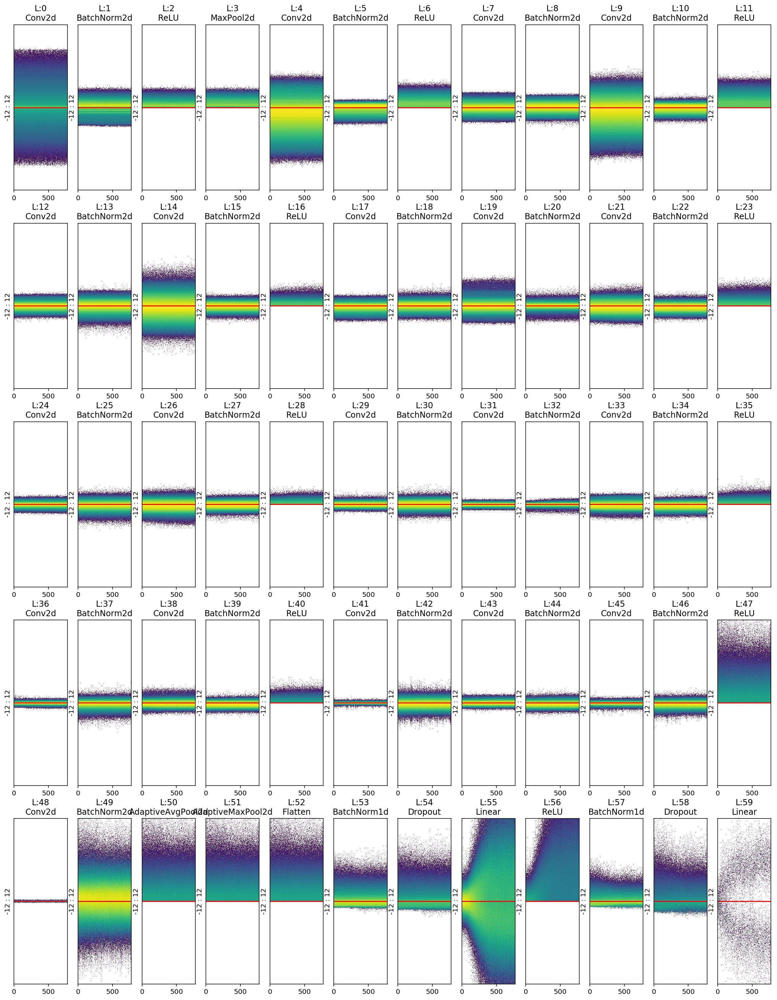

In [5]:
learn.activations_histogram.plotActsHist(cols=12, figsize=(20,26), showEpochs=False)

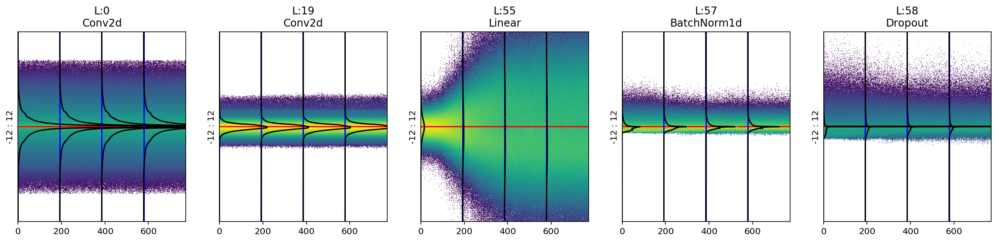

In [6]:
learn.activations_histogram.plotActsHist(toDisplay=[0,19,55,57,58], figsize=(20,4), hScale=.05, cols=5)

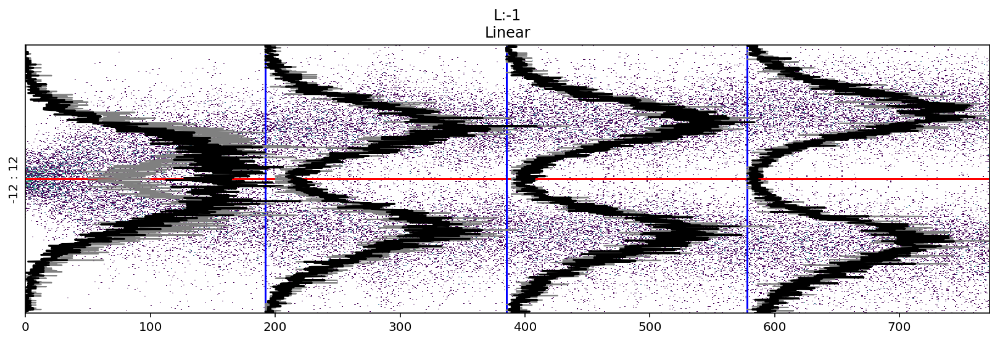

In [7]:
learn.activations_histogram.plotActsHist(toDisplay=-1, figsize=(14,4), hScale=400)

## Learning rate too low

epoch,train_loss,valid_loss,accuracy,time
0,0.563751,0.348685,0.870461,00:10
1,0.305620,0.226782,0.921492,00:11
2,0.248610,0.193779,0.932287,00:16
3,0.239571,0.190691,0.931305,00:19


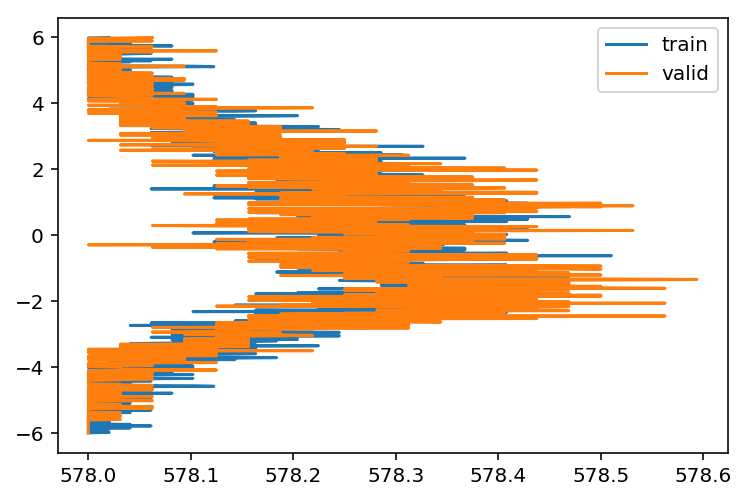

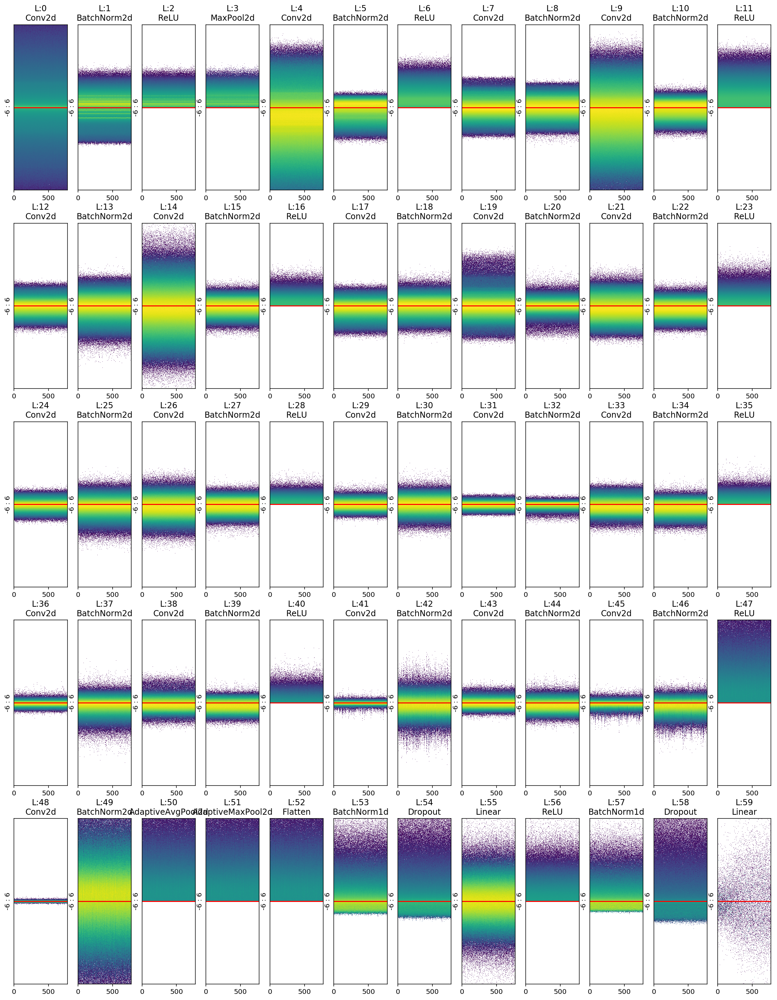

In [8]:
actsh = partial(ActivationsHistogram, hMin=-6, hMax=6, nBins=800, modulesId=None)
learn = cnn_learner(data, models.resnet18, callback_fns=actsh, metrics=[accuracy])
learn.fit_one_cycle(4,max_lr=slice(1e-4))
learn.activations_histogram.plotActsHist(cols=12, figsize=(20,26), showEpochs=False)

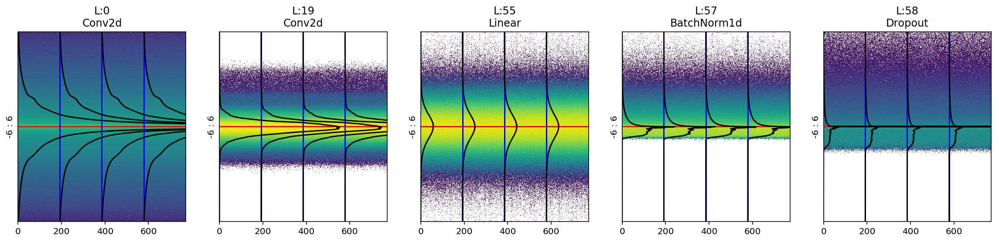

In [9]:
learn.activations_histogram.plotActsHist(toDisplay=[0,19,55,57,58], figsize=(20,4), hScale=.25, cols=5)

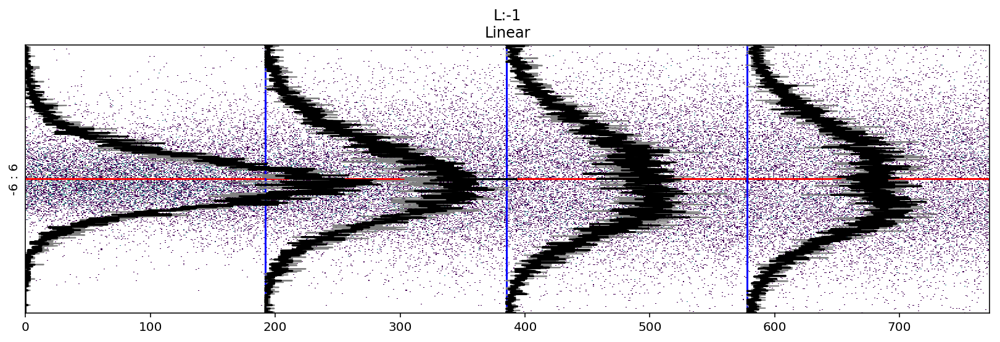

In [10]:
learn.activations_histogram.plotActsHist(toDisplay=-1, figsize=(14,4), hScale=350)

## Learning rate very high

epoch,train_loss,valid_loss,accuracy,time
0,0.141874,0.755230,0.940628,00:10
1,0.350306,0.077142,0.993131,00:14
2,0.105550,0.022563,0.998037,00:16
3,0.046594,0.010688,0.999019,00:19


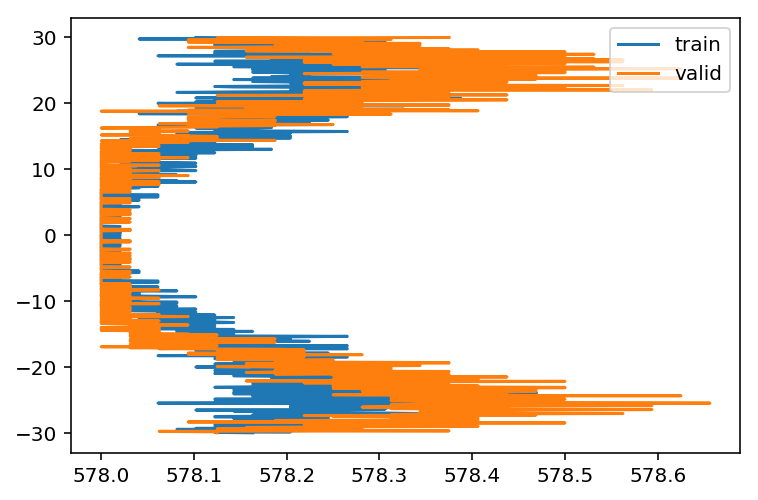

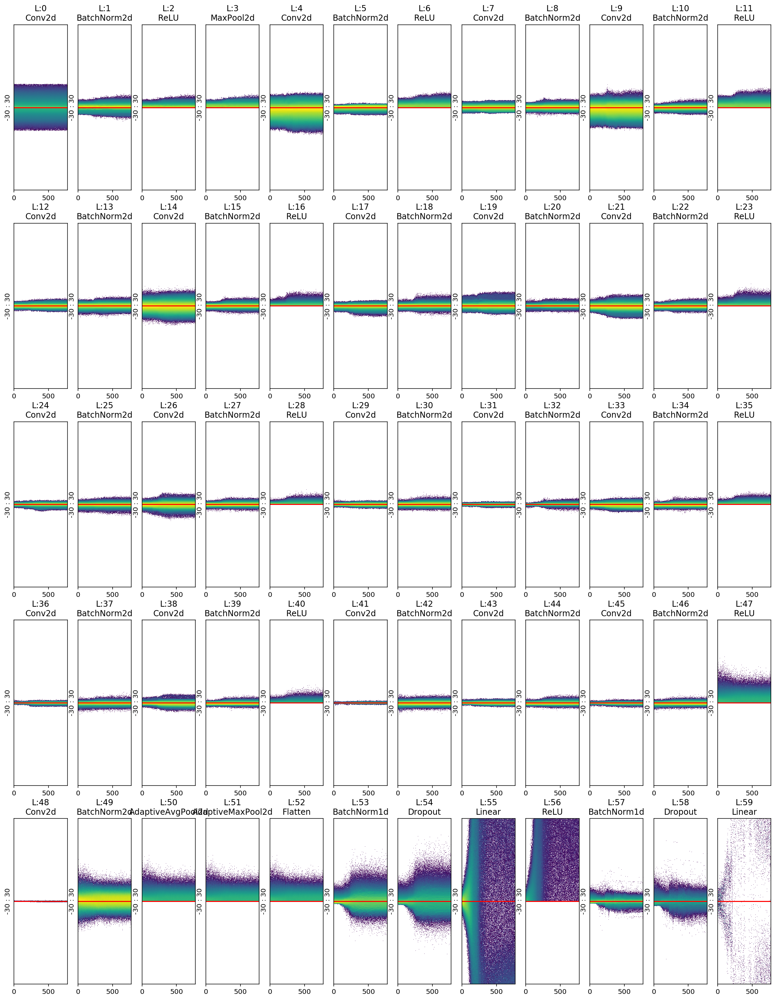

In [11]:
actsh = partial(ActivationsHistogram, hMin=-30, hMax=30, nBins=800, modulesId=None)
learn = cnn_learner(data, models.resnet18, callback_fns=actsh, metrics=[accuracy])
learn.fit_one_cycle(4,max_lr=slice(1e-1))
learn.activations_histogram.plotActsHist(cols=12, figsize=(20,26), showEpochs=False)

**OBSERVATIONS:** 
During the cycle, after Linear Layer L55 the activations exploded, get spreaded around very large values, but the BatchNorm on L57 save the situation, normalizing back the activations to reasonable values so that the model converged again.

It's interesting to note too that, despite the high values of learning rate, the "convolutional part" of resnet (L0-L54) tends to deal very well with activation explosion, probably due to the normalizing effect of BatchNorm.

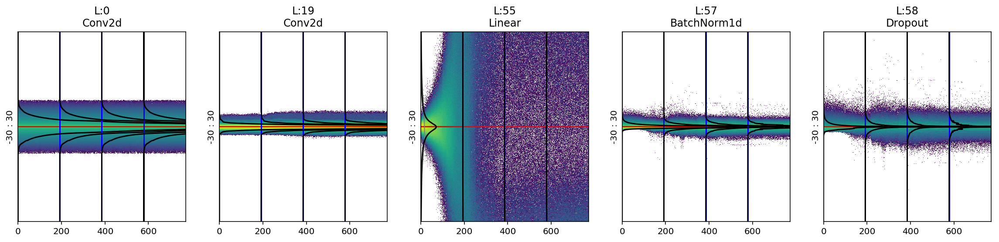

In [12]:
learn.activations_histogram.plotActsHist(toDisplay=[0,19,55,57,58], figsize=(20,4), hScale=.25, cols=5)

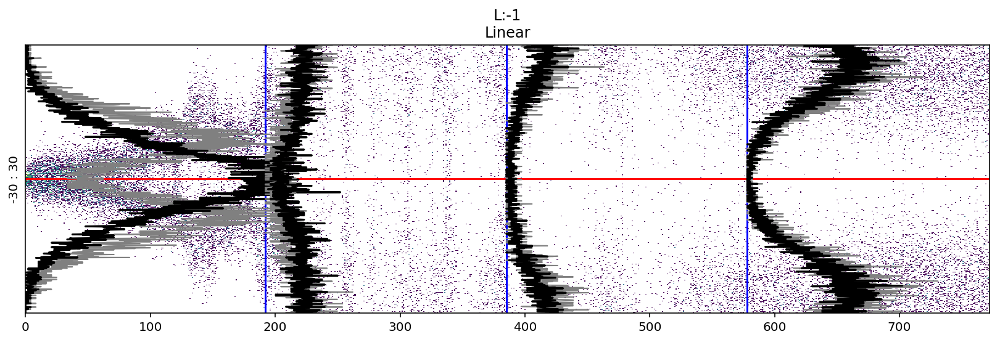

In [13]:
learn.activations_histogram.plotActsHist(toDisplay=-1, figsize=(14,4), hScale=400)

**Last thought, maybe it's a coincidence, but with very high learning rate around 1e-1 we've got better performance both in terms of accuracy and loss than reasonable LR 1e-2 (the LR that lr_finder is suggesting), behaviour that seems to confirm the ipothesis that higher peak separation means a better model.**

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 2.51E-03
Min loss divided by 10: 3.02E-02


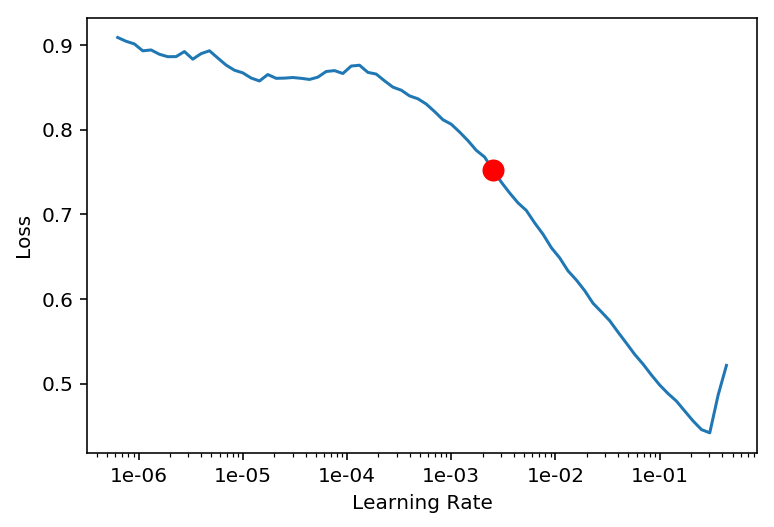

In [14]:
learn = cnn_learner(data, models.resnet18, metrics=[accuracy])
learn.lr_find()
learn.recorder.plot(suggestion=True)

## Wrong learning rate

epoch,train_loss,valid_loss,accuracy,time
0,26204.255859,1714.601196,0.495584,00:12
1,12836.401367,3444265.500000,0.495584,00:13
2,868.169983,13.232006,0.495584,00:16
3,17.710426,0.060741,0.978410,00:19


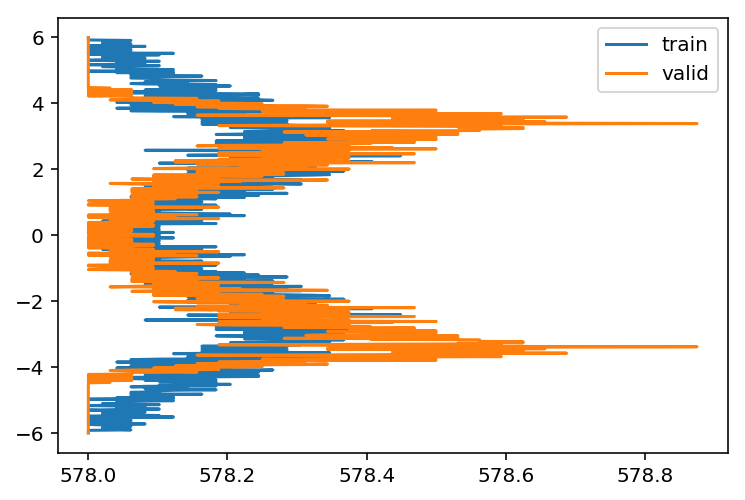

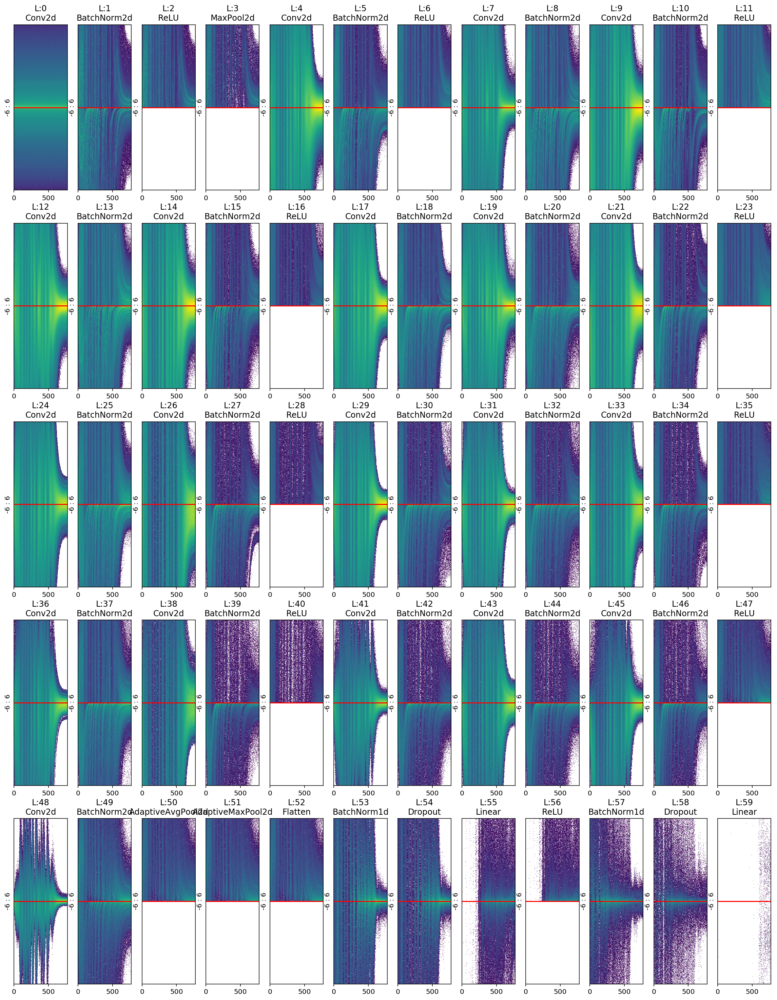

In [15]:
actsh = partial(ActivationsHistogram, hMin=-6, hMax=6, nBins=800, modulesId=None)
learn = cnn_learner(data, models.resnet18, callback_fns=actsh, metrics=[accuracy])
learn.fit_one_cycle(4,max_lr=slice(100))
learn.activations_histogram.plotActsHist(cols=12, figsize=(20,26), showEpochs=False)

As it's clearly visible from the intermediate layers, the activations inside the network are junping around big values.
Even if eventually, in some cases, the model tends to have a correct behaviour, results are worse than previous LR values.

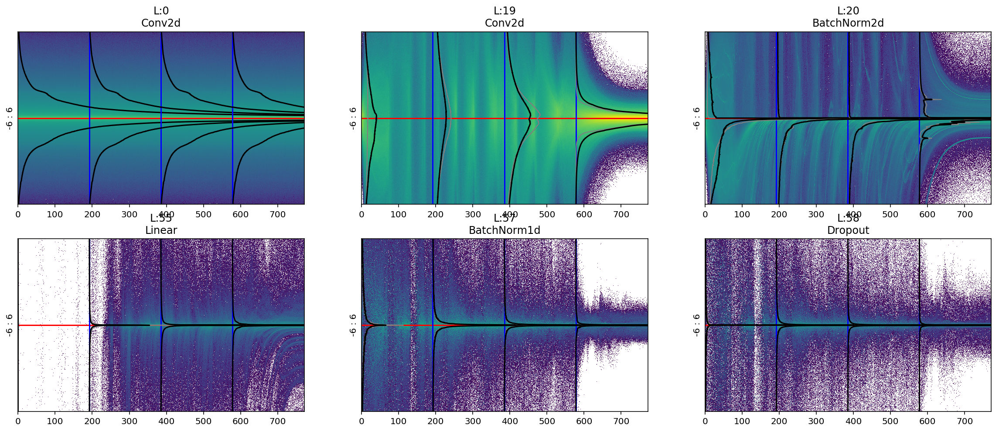

In [17]:
learn.activations_histogram.plotActsHist(toDisplay=[0,19,20,55,57,58], figsize=(20,8), hScale=.25, cols=3)

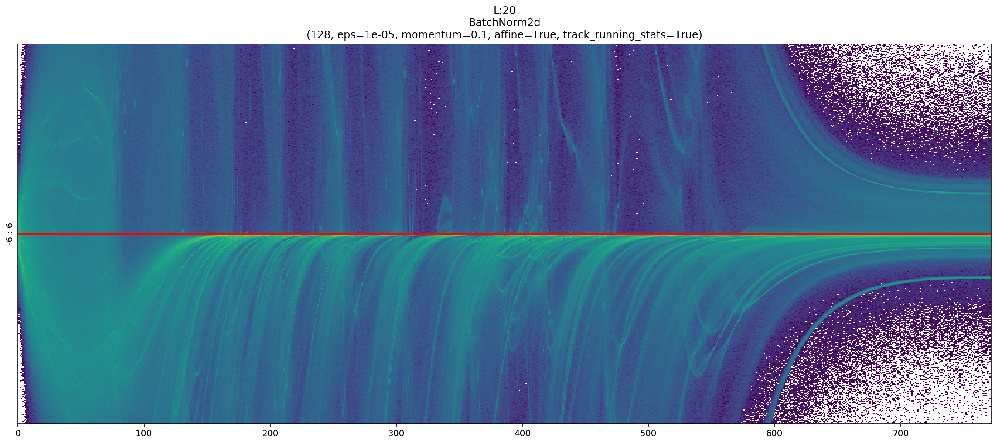

In [19]:
learn.activations_histogram.plotActsHist(toDisplay=20, figsize=(20,8), hScale=.25, showEpochs=False, showLayerType=True)

Despite the fact that the model is training very bad, the activations pictures are so cool ;-)